### Libraries

In [1]:
import pandas as pd
pd.set_option('display.max_rows',500)
import numpy as np

from matplotlib import pyplot as plt
import seaborn as sns

%matplotlib inline


from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

import plotly.plotly as py
import plotly.graph_objs as go


### Functions

In [2]:
def plotTS(df, columns=['High', 'Low'], title='Title'):
    """Plotly Time Series Plot.  
    Note: Maybe be slow plotting more than 10^5 points.
    Assumes df has time series index."""
    
    data = []
    for column in columns:
        toPlot = go.Scatter( x=df.index, y=df[column], name = column, opacity = 0.8)
        data.append(toPlot)

    layout = dict(title=title)

    fig = dict(data=data, layout=layout)
    return iplot(fig, config={'showLink':False})
    

### Read Data

In [3]:
df = pd.read_csv('./bitstampUSD_1-min_data_2012-01-01_to_2017-10-20.csv.zip')

In [4]:
df.head()

,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
0,1325317920,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
1,1325317980,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
2,1325318040,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
3,1325318100,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
4,1325318160,4.39,4.39,4.39,4.39,0.455581,2.0,4.39


In [5]:
df['Time'] = pd.to_datetime(df['Timestamp'], unit='s')

In [6]:
df.head()

,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price,Time
0,1325317920,4.39,4.39,4.39,4.39,0.455581,2.0,4.39,2011-12-31 07:52:00
1,1325317980,4.39,4.39,4.39,4.39,0.455581,2.0,4.39,2011-12-31 07:53:00
2,1325318040,4.39,4.39,4.39,4.39,0.455581,2.0,4.39,2011-12-31 07:54:00
3,1325318100,4.39,4.39,4.39,4.39,0.455581,2.0,4.39,2011-12-31 07:55:00
4,1325318160,4.39,4.39,4.39,4.39,0.455581,2.0,4.39,2011-12-31 07:56:00


In [7]:
df = df.set_index(df['Time'])

In [8]:
df = df.drop(['Timestamp', 'Time'], axis=1)

### Data Exploration

In [9]:
df.shape

(3045857, 7)

In [10]:
hourly = df.resample('60min').agg({'Open':'first', 
                             'High':'max', 
                             'Low':'min', 
                             'Close':'last', 
                             'Volume_(BTC)':'sum', 
                             'Volume_(Currency)':'sum'})

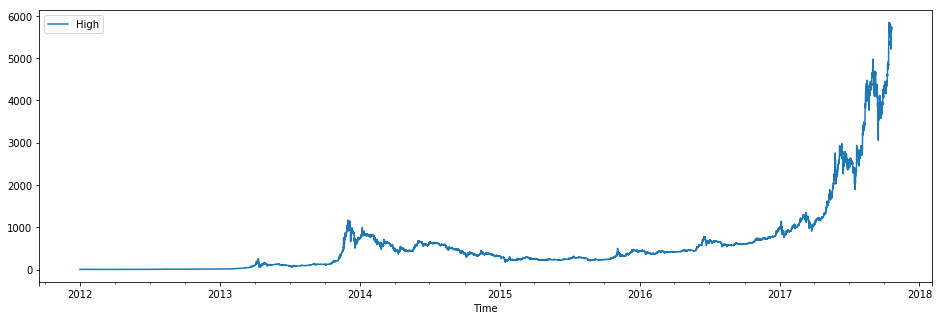

In [11]:
hourly.plot(kind='line', y='High', figsize=(16,5))

In [12]:
plotTS(hourly, ['High', 'Low'], 'BTC Hourly High/Low')

In [ ]:
df[df['Close'] == 1.5]

In [16]:
firstDate = pd.to_datetime('2016-06-23 12:30:00')
lastDate = pd.to_datetime('2016-06-23 12:40:00')

In [17]:
df[(df.index >= firstDate) & (df.index<=lastDate)]

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
Time,,,,,,,
2016-06-23 12:30:00,591.27,591.27,591.27,591.27,0.033741,19.950000,591.270000
2016-06-23 12:31:00,591.26,591.26,591.26,591.26,0.962179,568.897855,591.260000
2016-06-23 12:32:00,590.56,591.27,590.54,591.27,4.664146,2754.490206,590.566942
2016-06-23 12:33:00,590.54,591.27,590.54,591.27,0.109955,64.980254,590.969515
2016-06-23 12:34:00,591.27,591.27,590.40,590.40,13.603897,8033.758712,590.548329
2016-06-23 12:35:00,590.40,590.40,586.71,588.56,44.446616,26130.846632,587.915323
2016-06-23 12:36:00,586.80,588.53,1.50,1.50,54.486076,29003.437329,532.309155
2016-06-23 12:37:00,585.17,587.57,584.06,584.06,20.770370,12151.069547,585.019395
2016-06-23 12:38:00,587.40,587.40,587.15,587.15,0.208981,122.715344,587.208476


In [18]:
df.loc[pd.to_datetime("2016-06-23 12:36:00"), 'Close'] = 585.17
df.loc[pd.to_datetime("2016-06-23 12:36:00"), 'Low'] = 585.17

In [19]:
df[(df.index >= firstDate) & (df.index<=lastDate)]

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
Time,,,,,,,
2016-06-23 12:30:00,591.27,591.27,591.27,591.27,0.033741,19.950000,591.270000
2016-06-23 12:31:00,591.26,591.26,591.26,591.26,0.962179,568.897855,591.260000
2016-06-23 12:32:00,590.56,591.27,590.54,591.27,4.664146,2754.490206,590.566942
2016-06-23 12:33:00,590.54,591.27,590.54,591.27,0.109955,64.980254,590.969515
2016-06-23 12:34:00,591.27,591.27,590.40,590.40,13.603897,8033.758712,590.548329
2016-06-23 12:35:00,590.40,590.40,586.71,588.56,44.446616,26130.846632,587.915323
2016-06-23 12:36:00,586.80,588.53,585.17,585.17,54.486076,29003.437329,532.309155
2016-06-23 12:37:00,585.17,587.57,584.06,584.06,20.770370,12151.069547,585.019395
2016-06-23 12:38:00,587.40,587.40,587.15,587.15,0.208981,122.715344,587.208476


In [20]:
hourly = df.resample('60min').agg({'Open':'first', 
                             'High':'max', 
                             'Low':'min', 
                             'Close':'last', 
                             'Volume_(BTC)':'sum', 
                             'Volume_(Currency)':'sum'})

In [21]:
plotTS(hourly, ['High', 'Low'], 'BTC Hourly High/Low')

### Select Dataset

In [22]:
hourly = hourly[hourly.index >= "2016-01-01"]

<h4> Look at how trade volumes vary during the day

In [23]:
# average trade volumes per hour

tradesByHour = hourly.groupby(hourly.index.hour)['Volume_(BTC)'].agg(['std','mean'])

In [24]:
tradesByHour

,std,mean
Time,,
0,321.015302,311.280031
1,317.085951,306.663050
2,317.003499,294.992300
3,291.213680,283.388545
4,296.757899,282.175966
5,326.296101,295.960356
6,366.529651,324.024068
7,374.954704,363.498158
8,388.341503,399.268599


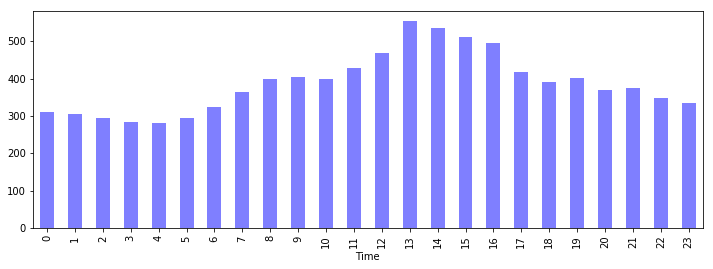

In [25]:
tradesByHour['mean'].plot(kind='bar', color='b', alpha=0.5, figsize=(12,4))

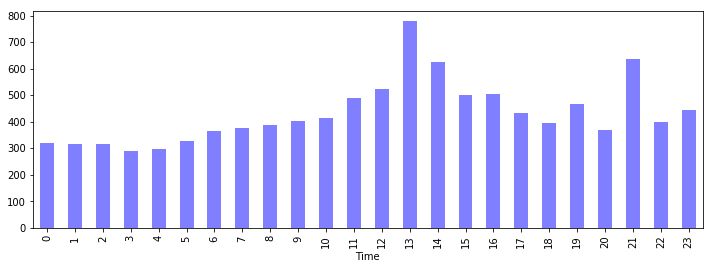

In [26]:
tradesByHour['std'].plot(kind='bar', color='b', alpha=0.5, figsize=(12,4))

In [ ]:
plotTS(hourly, ['High', 'Low'], 'BTC Hourly High/Low')

In [ ]:
hourly['High Diff'] = hourly['High'].diff()

plotTS(hourly, ['High Diff'], 'BTC Hourly Change in High')

In [29]:
df['Log High Diff'] = np.log(df['High']).diff()


In [ ]:
hourly['Log High Diff'] = np.log(hourly['High']).diff()

plotTS(hourly, ['Log High Diff'], 'BTC Hourly Change in High')

In [31]:
hourly.head()

,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),High Diff,Log High Diff
Time,,,,,,,,
2016-01-01 00:00:00,429.77,432.58,429.77,431.02,56.066443,24193.588952,NaN,NaN
2016-01-01 01:00:00,431.51,432.01,429.08,430.01,55.971752,24071.998535,-0.57,-0.001319
2016-01-01 02:00:00,430.01,431.69,430.00,430.57,34.585620,14885.641797,-0.32,-0.000741
2016-01-01 03:00:00,430.57,433.37,430.03,433.37,87.912725,38008.546028,1.68,0.003884
2016-01-01 04:00:00,432.30,435.72,432.30,435.11,895.755600,389092.061125,2.35,0.005408


In [32]:
import statsmodels.api as sm

C:\Users\Mike\Anaconda2\envs\mike_test_py3\lib\site-packages\statsmodels\compat\pandas.py:56: FutureWarning:

The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.



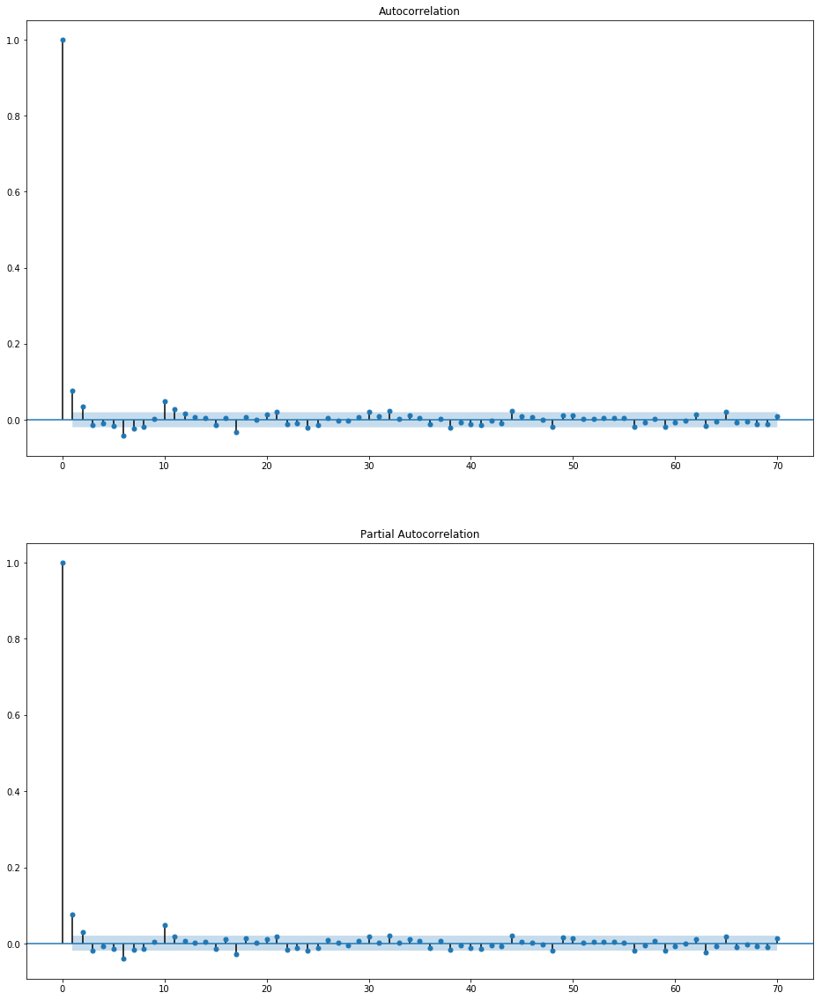

In [36]:
columnOfInterest = 'Log High Diff'

fig, ax = plt.subplots(2, 1, figsize=(16,20))
fig = sm.graphics.tsa.plot_acf(df.tail(10000)[columnOfInterest].dropna().get_values(), lags=70, ax=ax[0])
fig = sm.graphics.tsa.plot_pacf(df.tail(10000)[columnOfInterest].dropna().get_values(), lags=70, ax=ax[1])

In [ ]:
# plot correlations

numberLags = 12
columnToPlot = 'Log High Diff'

fig, ax = plt.subplots(numberLags+1, 1, figsize=(9, 9*(numberLags+1)))

for lag in range(0, numberLags+1):
    
    df['lagged'] = df[columnToPlot].shift(lag)
    
    df.tail(100000).plot(kind='scatter', x=columnToPlot, y='lagged', ax=ax[lag], alpha=0.1)